# Store Sales Forecasting

In [1]:
#import libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
#Load the datasets
train_data=pd.read_csv("./Dataset/train.csv")
test_data=pd.read_csv("./Dataset/test.csv")
features_data=pd.read_csv("./Dataset/features.csv")
stores_data=pd.read_csv("./Dataset/stores.csv")


In [3]:
#inspect data, print summary statistics
print(train_data.info())
print("\n Any Null values :\n",train_data.isnull().any())
train_data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421570 entries, 0 to 421569
Data columns (total 5 columns):
Store           421570 non-null int64
Dept            421570 non-null int64
Date            421570 non-null object
Weekly_Sales    421570 non-null float64
IsHoliday       421570 non-null bool
dtypes: bool(1), float64(1), int64(2), object(1)
memory usage: 13.3+ MB
None

 Any Null values :
 Store           False
Dept            False
Date            False
Weekly_Sales    False
IsHoliday       False
dtype: bool


,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,2010-02-05,24924.50,False
1,1,1,2010-02-12,46039.49,True
2,1,1,2010-02-19,41595.55,False
3,1,1,2010-02-26,19403.54,False
4,1,1,2010-03-05,21827.90,False


there are no null values in the train_data

In [4]:
#inspect data, print summary statistics
print(features_data.info())
print("\n Any Null values :\n",features_data.isnull().any())
features_data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8190 entries, 0 to 8189
Data columns (total 12 columns):
Store           8190 non-null int64
Date            8190 non-null object
Temperature     8190 non-null float64
Fuel_Price      8190 non-null float64
MarkDown1       4032 non-null float64
MarkDown2       2921 non-null float64
MarkDown3       3613 non-null float64
MarkDown4       3464 non-null float64
MarkDown5       4050 non-null float64
CPI             7605 non-null float64
Unemployment    7605 non-null float64
IsHoliday       8190 non-null bool
dtypes: bool(1), float64(9), int64(1), object(1)
memory usage: 712.0+ KB
None

 Any Null values :
 Store           False
Date            False
Temperature     False
Fuel_Price      False
MarkDown1        True
MarkDown2        True
MarkDown3        True
MarkDown4        True
MarkDown5        True
CPI              True
Unemployment     True
IsHoliday       False
dtype: bool


,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False


There are missing values in the dataset,impute missing values by filling those by 0 for markdown coulmns and by mean value for CPI and Unemployment

In [5]:
features_data["MarkDown1"]=features_data["MarkDown1"].fillna(0)
features_data["MarkDown2"]=features_data["MarkDown2"].fillna(0)
features_data["MarkDown3"]=features_data["MarkDown3"].fillna(0)
features_data["MarkDown4"]=features_data["MarkDown4"].fillna(0)
features_data["MarkDown5"]=features_data["MarkDown5"].fillna(0)
features_data.isnull().any()
features_data.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,0.0,0.0,0.0,0.0,0.0,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,0.0,0.0,0.0,0.0,0.0,211.289143,8.106,False
3,1,2010-02-26,46.63,2.561,0.0,0.0,0.0,0.0,0.0,211.319643,8.106,False
4,1,2010-03-05,46.50,2.625,0.0,0.0,0.0,0.0,0.0,211.350143,8.106,False


In [6]:
features_data["CPI"]=features_data["CPI"].fillna(features_data["CPI"].mean())
features_data["Unemployment"]=features_data["Unemployment"].fillna(features_data["Unemployment"].mean())
features_data.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,0.0,0.0,0.0,0.0,0.0,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,0.0,0.0,0.0,0.0,0.0,211.289143,8.106,False
3,1,2010-02-26,46.63,2.561,0.0,0.0,0.0,0.0,0.0,211.319643,8.106,False
4,1,2010-03-05,46.50,2.625,0.0,0.0,0.0,0.0,0.0,211.350143,8.106,False


In [7]:
features_data.isnull().any()

Store           False
Date            False
Temperature     False
Fuel_Price      False
MarkDown1       False
MarkDown2       False
MarkDown3       False
MarkDown4       False
MarkDown5       False
CPI             False
Unemployment    False
IsHoliday       False
dtype: bool

In [8]:
#inspect data, print summary statistics
print(stores_data.info())
print("\n Any Null values :\n",stores_data.isnull().any())
stores_data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45 entries, 0 to 44
Data columns (total 3 columns):
Store    45 non-null int64
Type     45 non-null object
Size     45 non-null int64
dtypes: int64(2), object(1)
memory usage: 1.2+ KB
None

 Any Null values :
 Store    False
Type     False
Size     False
dtype: bool


,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392
3,4,A,205863
4,5,B,34875


In [9]:
#merging stores, features and train data
merged_data=pd.merge(pd.merge(train_data,features_data),stores_data)

In [10]:
merged_data.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Type,Size
0,1,1,2010-02-05,24924.50,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,A,151315
1,1,2,2010-02-05,50605.27,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,A,151315
2,1,3,2010-02-05,13740.12,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,A,151315
3,1,4,2010-02-05,39954.04,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,A,151315
4,1,5,2010-02-05,32229.38,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,A,151315


In [11]:
merged_data.shape

(421570, 16)

In [12]:
merged_data.isnull().any()

Store           False
Dept            False
Date            False
Weekly_Sales    False
IsHoliday       False
Temperature     False
Fuel_Price      False
MarkDown1       False
MarkDown2       False
MarkDown3       False
MarkDown4       False
MarkDown5       False
CPI             False
Unemployment    False
Type            False
Size            False
dtype: bool

In [13]:
test_data.head()

,Store,Dept,Date,IsHoliday
0,1,1,2012-11-02,False
1,1,1,2012-11-09,False
2,1,1,2012-11-16,False
3,1,1,2012-11-23,True
4,1,1,2012-11-30,False


using hvplot for visualizations


In [14]:
#pip install hvplot
import hvplot.pandas


Exploring data to see how having a holiday influences Weekly sales when compared against Size, Fuel , Markdowns

In [15]:
merged_data.hvplot(x="Temperature",y="Weekly_Sales",by="IsHoliday",kind='scatter',height=500)


:NdOverlay   [IsHoliday]
   :Scatter   [Temperature]   (Weekly_Sales)

In [16]:
merged_data.hvplot(x="Size",y="Weekly_Sales",by="IsHoliday",kind='scatter')

:NdOverlay   [IsHoliday]
   :Scatter   [Size]   (Weekly_Sales)

In [17]:
merged_data.hvplot(x="Fuel_Price",y="Weekly_Sales",by="IsHoliday",kind='scatter')

:NdOverlay   [IsHoliday]
   :Scatter   [Fuel_Price]   (Weekly_Sales)

In [18]:
merged_data["merged_markdown"]=merged_data["MarkDown1"]+merged_data["MarkDown2"]+merged_data["MarkDown3"]+merged_data["MarkDown4"]+merged_data["MarkDown5"]

In [19]:
merged_data.hvplot(x="merged_markdown",y="Weekly_Sales",by="IsHoliday",kind='scatter')

:NdOverlay   [IsHoliday]
   :Scatter   [merged_markdown]   (Weekly_Sales)

From the above plots we can infer that sales reaches it peak  when there is a holiday

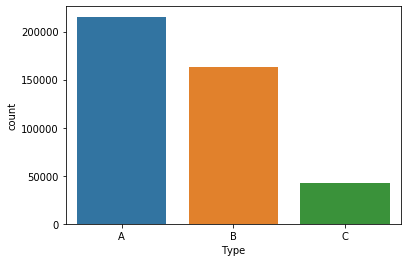

In [20]:
sns.countplot(x="Type",data=merged_data)

In [21]:
merged_data.hvplot.box('Size', by='Type')

:BoxWhisker   [Type]   (Size)

From the above plot we can infer that the types are based on the Size , like Type A stores are larger compared to B and C

In [22]:
merged_data.hvplot.box('Weekly_Sales', by='Store',height=400,width=1000)

:BoxWhisker   [Store]   (Weekly_Sales)

In [23]:
import datetime 
merged_data["Date"]=pd.to_datetime(merged_data["Date"])

Exploring date and sales

In [24]:
merged_data["Month"]=merged_data["Date"].dt.month
merged_data.hvplot.violin(y='Weekly_Sales', by='Month', groupby='IsHoliday', height=500)


:DynamicMap   [IsHoliday]
   :Violin   [Month]   (Weekly_Sales)

In [25]:
merged_data["Year"]=merged_data["Date"].dt.year
merged_data.hvplot.violin(y='Weekly_Sales', by='Year', groupby='IsHoliday', height=500)



:DynamicMap   [IsHoliday]
   :Violin   [Year]   (Weekly_Sales)

In [26]:
merged_data["Day"]=merged_data["Date"].dt.day


In [27]:
merged_data.hvplot.violin(y='Weekly_Sales', by='Day', groupby='IsHoliday', height=500,width=700)

:DynamicMap   [IsHoliday]
   :Violin   [Day]   (Weekly_Sales)

Explore the correlation between features

In [28]:
merged_data=merged_data.drop(['merged_markdown','Date'], axis=1)

[]

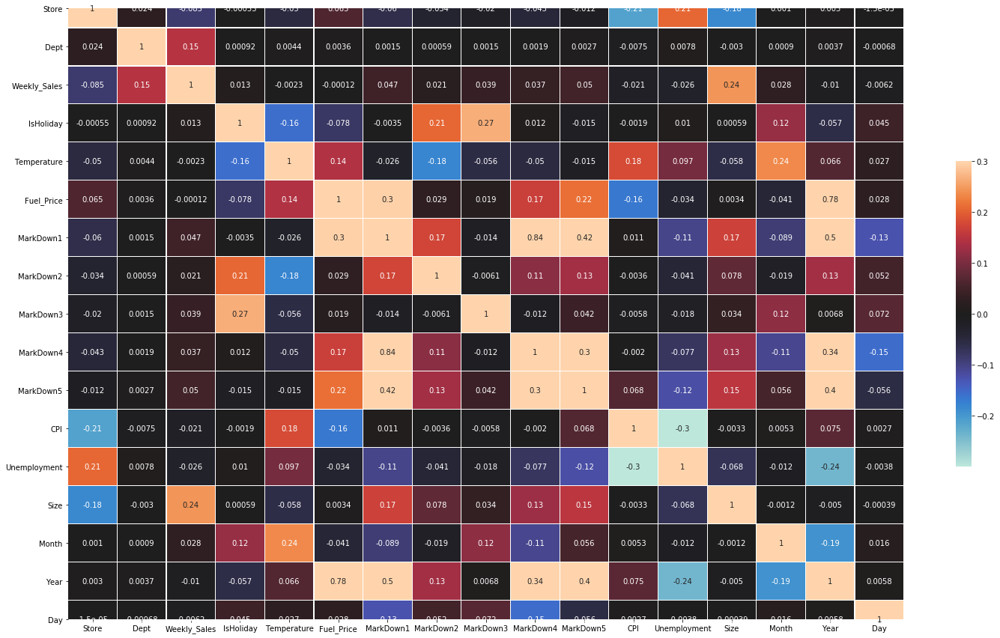

In [29]:
c_r= merged_data.corr()
plt.figure(figsize=(25, 15))
sns.heatmap(c_r, vmax=.3, center=0, annot=True,linewidths=.2, cbar_kws={"shrink": .5})
plt.plot()

Encoding the categorical features 

In [30]:
mergeddata=pd.get_dummies(merged_data,columns=["Type"])

In [31]:
mergeddata.head()

,Store,Dept,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size,Month,Year,Day,Type_A,Type_B,Type_C
0,1,1,24924.50,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
1,1,2,50605.27,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
2,1,3,13740.12,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
3,1,4,39954.04,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
4,1,5,32229.38,False,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0


In [32]:
from sklearn.preprocessing import LabelEncoder
lencode=LabelEncoder()
mergeddata["IsHoliday"]=lencode.fit_transform(mergeddata["IsHoliday"])

In [33]:
mergeddata.head()

,Store,Dept,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size,Month,Year,Day,Type_A,Type_B,Type_C
0,1,1,24924.50,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
1,1,2,50605.27,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
2,1,3,13740.12,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
3,1,4,39954.04,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
4,1,5,32229.38,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0


defining the features and predictors

In [34]:
y=mergeddata["Weekly_Sales"]
x=mergeddata.drop(['Weekly_Sales'], axis=1)

In [35]:
x.head()

,Store,Dept,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size,Month,Year,Day,Type_A,Type_B,Type_C
0,1,1,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
1,1,2,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
2,1,3,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
3,1,4,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0
4,1,5,0,42.31,2.572,0.0,0.0,0.0,0.0,0.0,211.096358,8.106,151315,2,2010,5,1,0,0


split the data into train and test using cross validation

In [36]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 0)

Feature Scaling

In [37]:
from sklearn.preprocessing import StandardScaler
model=StandardScaler()
Xtrain=model.fit_transform(X_train)
Xtest=model.transform(X_test)

applying different ML Algorithms 

# Linear Regression 

In [38]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error

In [58]:
import numpy as np
model_lr = LinearRegression()
model_lr.fit(X_train, y_train)
predictions_lr = model_lr.predict(X_test)
weights_lr = X_test['IsHoliday'].replace(1, 5).replace(0, 1)
error_lr = mean_absolute_error(y_test, predictions_lr, sample_weight=weights_lr)
print("weighted Mean Absolute Error for Linear Regression : ",error_lr)

weighted Mean Absolute Error for Linear Regression :  14787.39753999154


Trying different ML algorthims before optimizing Linear Regression Model

# XGBoost

In [59]:
import xgboost as xgb
import warnings
warnings.filterwarnings("ignore")
model_xgb = xgb.XGBRegressor(objective='reg:squarederror')
model_xgb.fit(X_train, y_train)
predictions_xgb = model_xgb.predict(X_test)
weights_xgb = X_test['IsHoliday'].replace(1, 5).replace(0, 1)
error_xgb = mean_absolute_error(y_test, predictions_xgb, sample_weight=weights_xgb)
print("weighted Mean Absolute Error for XGBoost Regressor:",error_xgb)

weighted Mean Absolute Error for XGBoost Regressor: 7094.16486436693


The above error is better than Linear regressor , so will try finding best parameters using RandomSearchCV

In [44]:
from sklearn.model_selection import RandomizedSearchCV
params_xgb = {"max_depth":[3,4,5,6,7,8],
              "min_child_weight" : [4,6,7,8],
            'n_estimators':[10,20,30,40,50,60,70,80]}
XGB_RS = RandomizedSearchCV(xgb.XGBRegressor(objective='reg:squarederror'), param_distributions=params_xgb,n_iter=10,verbose=1,n_jobs=-1)
XGB_RS.fit(X_train,y_train)
XGB_RS.best_params_


Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:  2.0min finished


{'n_estimators': 70, 'min_child_weight': 6, 'max_depth': 7}

In [60]:
model_xgb_RS= xgb.XGBRegressor(learning_rate=0.5,max_depth=7,min_child_weight=6,n_estimators=70, objective='reg:squarederror')
model_xgb_RS.fit(X_train, y_train)
predictions_xgb_RS = model_xgb_RS.predict(X_test)
weights_xgb_RS = X_test['IsHoliday'].replace(1, 5).replace(0, 1)
error_xgb_RS = mean_absolute_error(y_test, predictions_xgb_RS, sample_weight=weights_xgb_RS)
print("weighted Mean Absolute Error for XGBoost Regressor using Random Search:",error_xgb_RS)

weighted Mean Absolute Error for XGBoost Regressor using Random Search: 2789.489131094631


# Random Forest Regressor 

In [61]:
from sklearn.ensemble import RandomForestRegressor
rfr = RandomForestRegressor()
rfr.fit(X_train,y_train)
predictions_rf = rfr.predict(X_test)
weights_rf = X_test['IsHoliday'].replace(1, 5).replace(0, 1)
error_rf = mean_absolute_error(y_test, predictions_rf, sample_weight=weights_rf)
print("weighted Mean Absolute Error for Random Forest Regressor:",error_rf)
print("\n The parameters used in the model : \n",rfr.get_params())

weighted Mean Absolute Error for Random Forest Regressor: 1678.7375781061571

 The parameters used in the model : 
 {'bootstrap': True, 'criterion': 'mse', 'max_depth': None, 'max_features': 'auto', 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_impurity_split': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 10, 'n_jobs': None, 'oob_score': False, 'random_state': None, 'verbose': 0, 'warm_start': False}


finding best parameters using RandomSearchCV

In [49]:
params_RF_RS = {"n_estimators": [10,20,30,40,50,60,70,80],
                "max_features":['auto', 'sqrt'],
              "min_samples_split":[2,3,4,5,6,7,8],
              "min_samples_leaf":[1,2,3,4,5,6,7,8,9,10]}
rfr_RS_model=RandomForestRegressor()
rfr_RS = RandomizedSearchCV(rfr_RS_model,param_distributions=params_RF_RS,n_iter=10,verbose=1,n_jobs=-1)
rfr_RS.fit(X_train,y_train)
rfr_RS.best_params_

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:  7.0min finished


{'n_estimators': 80,
 'min_samples_split': 3,
 'min_samples_leaf': 1,
 'max_features': 'auto'}

In [62]:
rfr_RS = RandomForestRegressor(max_features= 'auto', min_samples_leaf= 1, min_samples_split= 3,n_estimators=80)
rfr_RS.fit(X_train,y_train)
predictions_rf_RS = rfr_RS.predict(X_test)
weights_rf_RS = X_test['IsHoliday'].replace(1, 5).replace(0, 1)
error1_RS_RF= mean_absolute_error(y_test, predictions_rf_RS, sample_weight=weights_rf_RS)
print("weighted Mean Absolute Error for Random Forest Regressor using Random Search:",error1_RS_RF)

weighted Mean Absolute Error for Random Forest Regressor using Random Search: 1582.3612834502287


The weighted mean error was lowest for Random forest regressor using random search so will use the above model to predict  weekly sales on testdata

In [68]:
testdata=pd.read_csv("./Dataset/test.csv")
testdata=pd.merge(pd.merge(testdata,features_data),stores_data)

In [69]:
testdata.head()

,Store,Dept,Date,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Type,Size
0,1,1,2012-11-02,False,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,A,151315
1,1,2,2012-11-02,False,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,A,151315
2,1,3,2012-11-02,False,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,A,151315
3,1,4,2012-11-02,False,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,A,151315
4,1,5,2012-11-02,False,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,A,151315


In [70]:
testdata.isnull().any()

Store           False
Dept            False
Date            False
IsHoliday       False
Temperature     False
Fuel_Price      False
MarkDown1       False
MarkDown2       False
MarkDown3       False
MarkDown4       False
MarkDown5       False
CPI             False
Unemployment    False
Type            False
Size            False
dtype: bool

In [71]:
testdata=pd.get_dummies(testdata,columns=["Type"])

In [72]:
from sklearn.preprocessing import LabelEncoder
lencode1=LabelEncoder()
testdata["IsHoliday"]=lencode1.fit_transform(testdata["IsHoliday"])

In [74]:
testdata["Date"]=pd.to_datetime(testdata["Date"])
testdata["Day"]=testdata["Date"].dt.day
testdata["Year"]=testdata["Date"].dt.year
testdata["Month"]=testdata["Date"].dt.month
testdata=testdata.drop(["Date"],axis=1)
testdata.head()

,Store,Dept,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size,Type_A,Type_B,Type_C,Day,Year,Month
0,1,1,0,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,151315,1,0,0,2,2012,11
1,1,2,0,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,151315,1,0,0,2,2012,11
2,1,3,0,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,151315,1,0,0,2,2012,11
3,1,4,0,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,151315,1,0,0,2,2012,11
4,1,5,0,55.32,3.386,6766.44,5147.7,50.82,3639.9,2737.42,223.462779,6.573,151315,1,0,0,2,2012,11


predicting weekly sales for test data

In [83]:
#applying random forest regressor to train data
rfr_test = RandomForestRegressor(max_features= 'auto', min_samples_leaf= 1, min_samples_split= 3,n_estimators=80).fit(x,y)
predictions_test = rfr_test.predict(testdata)

Creating a result CSV based on the sample submission.csv

In [87]:
#Sample submission has only two columns with names ID and Weekly_sales
#Id is in the format 1_1_2012-11-02 so we need to append store and Dept to Date 
#Store the predictors to Weekly_sales
ID= test_data.Store.astype(str)+'_'+test_data.Dept.astype(str)+'_'+test_data.Year.astype(str)+'-'+test_data.Month.astype(str)+'-'+test_data.Day.astype(str)
Result = pd.DataFrame({"Id":ID, "Weekly_Sales": predictions_test})
Result.to_csv('FinalSubmission.csv', index=False)
